### Ejercicio 3


Investigue si las variables cuantitativas siguen una distribución normal y haga una tabla de frecuencias de las variables cualitativas. Explique todos los resultados.

c:\Users\Lenovo\AppData\Local\Programs\Python\Python313\Lib\site-packages\scipy\stats\_axis_nan_policy.py:586: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 10000.
  res = hypotest_fun_out(*samples, **kwds)


Resultados de las pruebas de normalidad:
                     Variable      Shapiro_p           KS_p
0                          id   7.918262e-70   0.000000e+00
1                      budget   4.705589e-94   0.000000e+00
2                     revenue  1.651197e-101   0.000000e+00
3                     runtime   4.642138e-70  1.295277e-181
4                  popularity  3.718788e-112   0.000000e+00
5                     voteAvg   1.954301e-35   9.379539e-19
6                   voteCount   2.615404e-96   0.000000e+00
7                genresAmount   2.643745e-61  1.717244e-295
8          productionCoAmount   2.194324e-84   0.000000e+00
9   productionCountriesAmount  2.514135e-108   0.000000e+00
10               actorsAmount  1.974067e-114   0.000000e+00


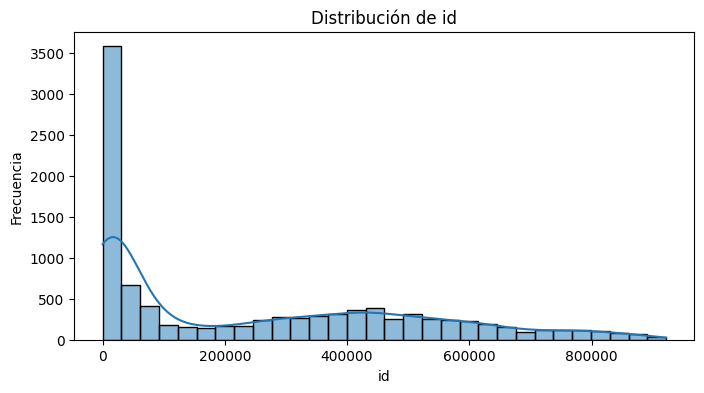

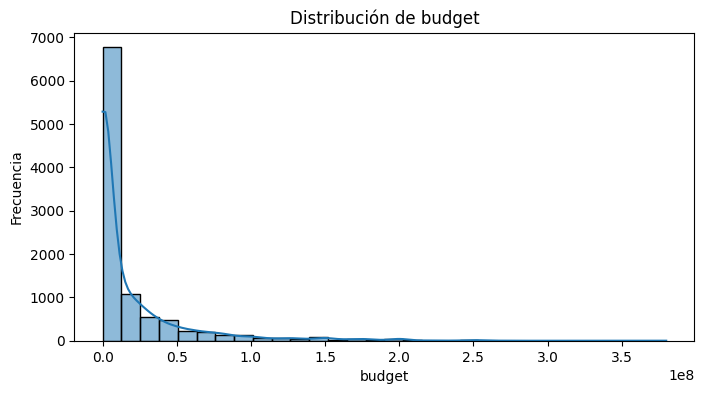

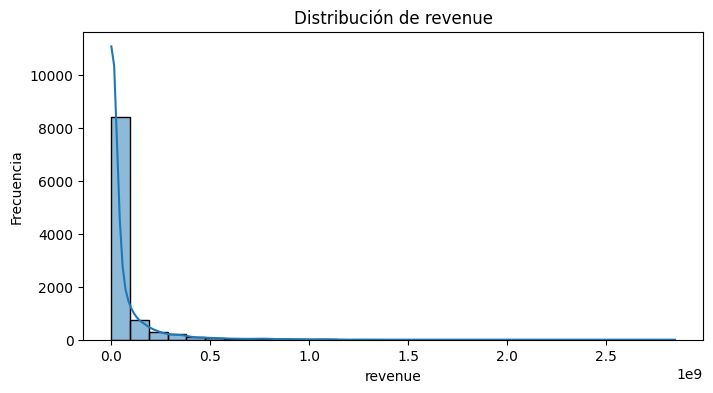

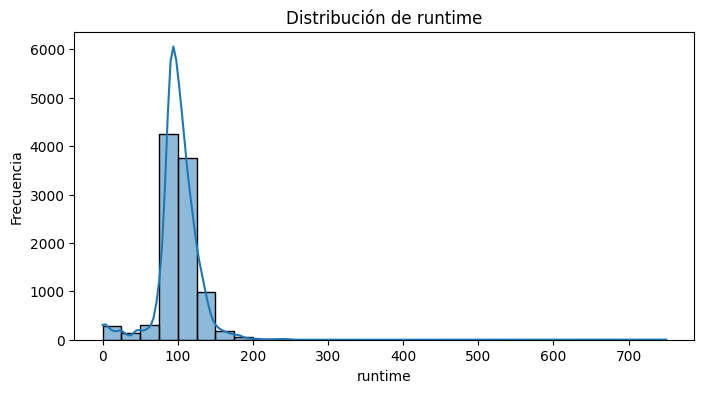

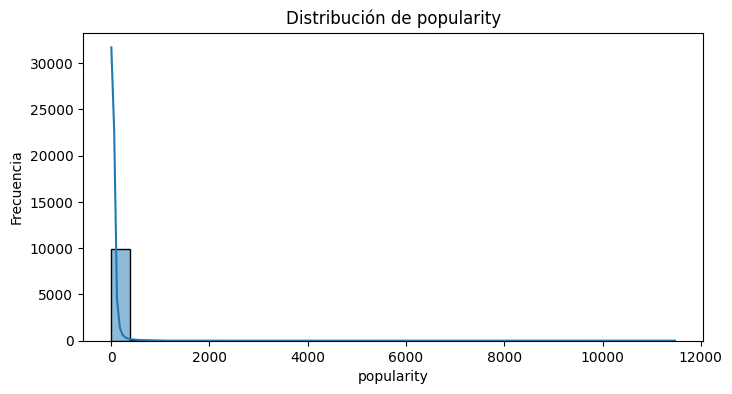

...

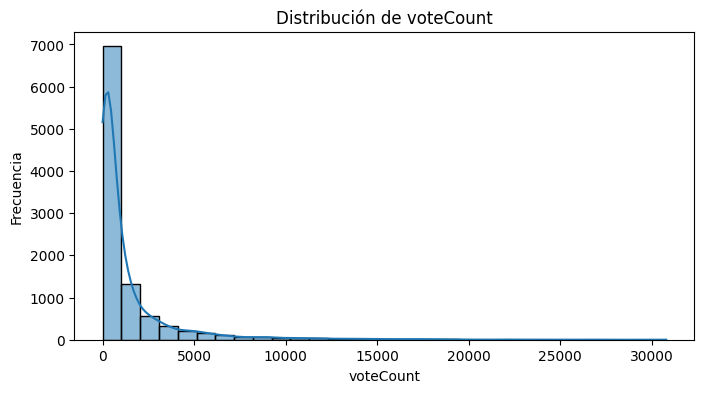

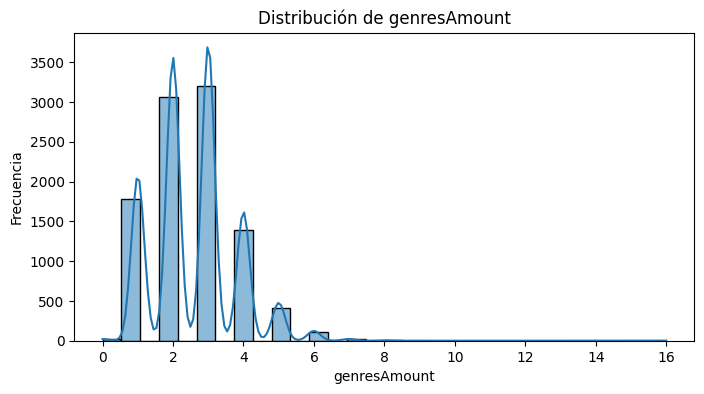

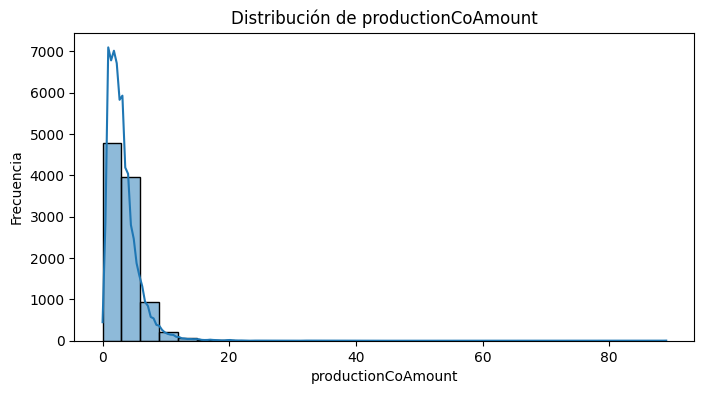

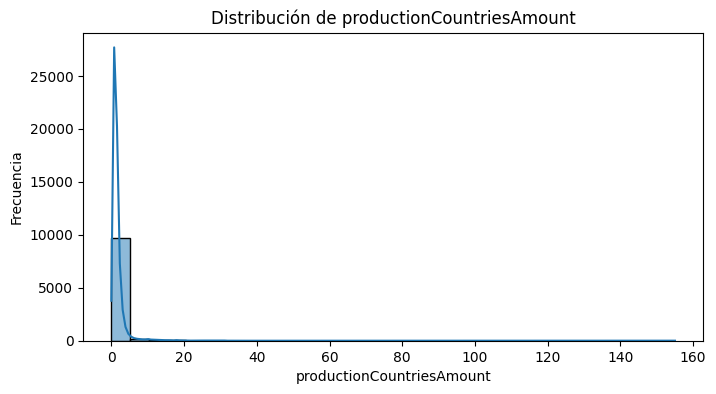

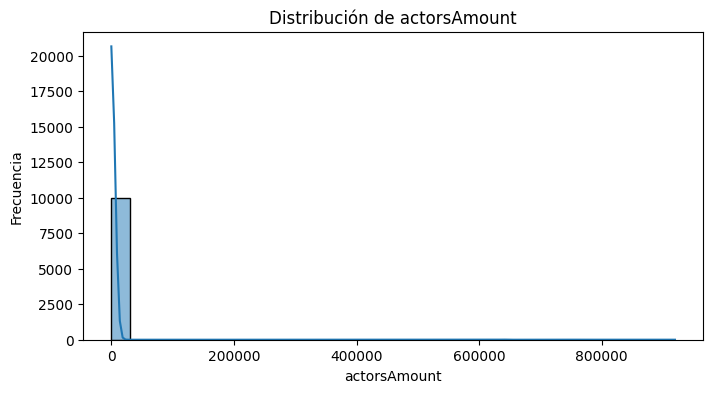

In [12]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.stats import shapiro, kstest, norm

# Cargar los datos
df = pd.read_csv('movies.csv', encoding='latin1')

# Seleccionar las variables cuantitativas
varcuantitativas = df.select_dtypes(include=["float64", "int64"]).columns

# Pruebas de normalidad
normalidadresultados = []
for col in varcuantitativas:
    data = df[col].dropna()
    if len(data) > 3:  # La prueba requiere al menos 3 datos
        # Prueba de Shapiro-Wilk
        stat_shapiro, p_shapiro = shapiro(data)
        # Prueba de Kolmogorov-Smirnov
        stat_ks, p_ks = kstest(data, 'norm', args=(data.mean(), data.std()))
        # Guardar resultados
        normalidadresultados.append({"Variable": col, "Shapiro_p": p_shapiro, "KS_p": p_ks})

# Convertir resultados en DataFrame
normalidad = pd.DataFrame(normalidadresultados)
print("Resultados de las pruebas de normalidad:")
print(normalidad)

# Visualización: Histogramas y gráficos de densidad
for col in varcuantitativas:
    data = df[col].dropna()
    plt.figure(figsize=(8, 4))
    sns.histplot(data, kde=True, bins=30)
    plt.title(f"Distribución de {col}")
    plt.xlabel(col)
    plt.ylabel("Frecuencia")
    plt.show()


In [13]:
# Seleccionar las variables cualitativas
varcualitativas = df.select_dtypes(include=["object"]).columns

# Calcular frecuencias absolutas y relativas
tablafrecuencia = {}
for col in varcualitativas:
    frecabs = df[col].value_counts()
    frecrel = df[col].value_counts(normalize=True) * 100
    tablafrecuencia[col] = pd.DataFrame({"Frecuencia Absoluta": frecabs, "Frecuencia Relativa (%)": frecrel})

# Mostrar las tablas de frecuencias
for col, freq_table in tablafrecuencia.items():
    print(f"Tabla de frecuencias para {col}:")
    print(freq_table)
    print("\n")


Tabla de frecuencias para genres:
                                                    Frecuencia Absoluta  \
genres                                                                    
Drama                                                               521   
Comedy                                                              440   
Horror                                                              230   
Drama|Romance                                                       211   
Horror|Thriller                                                     205   
Comedy|Romance                                                      201   
Documentary                                                         194   
Comedy|Drama                                                        140   
Action|Thriller                                                     121   
Action                                                              112   
Comedy|Drama|Romance                                              

In [14]:
import pandas as pd

# Cargar los datos
file_path = "movies.csv"  # Ajusta la ruta si es necesario
df = pd.read_csv(file_path, encoding="ISO-8859-1")

# Seleccionar las variables cualitativas
qualitative_vars = df.select_dtypes(include=["object"]).columns

# Calcular frecuencias absolutas y relativas para cada variable cualitativa
frequency_tables = {}
for col in qualitative_vars:
    # Reemplazar valores nulos con "N/A" para evitar problemas
    data = df[col].fillna("N/A")
    # Calcular frecuencia absoluta y relativa
    freq_abs = data.value_counts()
    freq_rel = data.value_counts(normalize=True) * 100
    # Crear una tabla para la variable actual
    frequency_tables[col] = pd.DataFrame({"Frecuencia Absoluta": freq_abs, "Frecuencia Relativa (%)": freq_rel})

# Mostrar las tablas de frecuencias
for col, freq_table in frequency_tables.items():
    print(f"Tabla de frecuencias para {col}:")
    print(freq_table)
    print("\n")

Tabla de frecuencias para genres:
                                                    Frecuencia Absoluta  \
genres                                                                    
Drama                                                               521   
Comedy                                                              440   
Horror                                                              230   
Drama|Romance                                                       211   
Horror|Thriller                                                     205   
Comedy|Romance                                                      201   
Documentary                                                         194   
Comedy|Drama                                                        140   
Action|Thriller                                                     121   
Action                                                              112   
Comedy|Drama|Romance                                              